In [ ]:
import numpy as np
from scipy.io import loadmat
import cvxpy as cp
import cv2 as cv
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt


keypoints = loadmat('keypoint3D.mat')['keypoints']
# keypoints = np.transpose(np.vstack((keypoints,[ 2.96202464e-01, -3.62132172e-01,  2.43598807e-01])))

In [ ]:
keypoints

array([[ 3.57983824e-01, -3.72683080e-01,  3.11800341e-01],
       [ 3.56490163e-01,  3.71753994e-01,  3.12240995e-01],
       [-3.57409781e-01,  3.70936601e-01,  3.12194781e-01],
       [-3.56632852e-01, -3.71349322e-01,  3.12294545e-01],
       [ 3.56775999e-01, -2.54264043e-01,  1.42638929e-04],
       [ 3.57198063e-01,  2.93192891e-01,  1.68673247e-03],
       [-3.55823763e-01,  2.94407287e-01,  1.69531064e-03],
       [-3.55063428e-01, -2.50690806e-01,  2.93928340e-03],
       [ 2.96202464e-01, -5.62132172e-01,  2.43598807e-01],
       [ 5.25819083e-01,  4.73696887e-01,  2.46265841e-01],
       [-5.28115513e-01,  4.72339810e-01,  2.46027345e-01]])

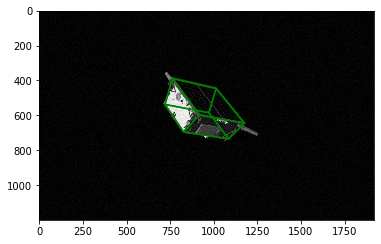

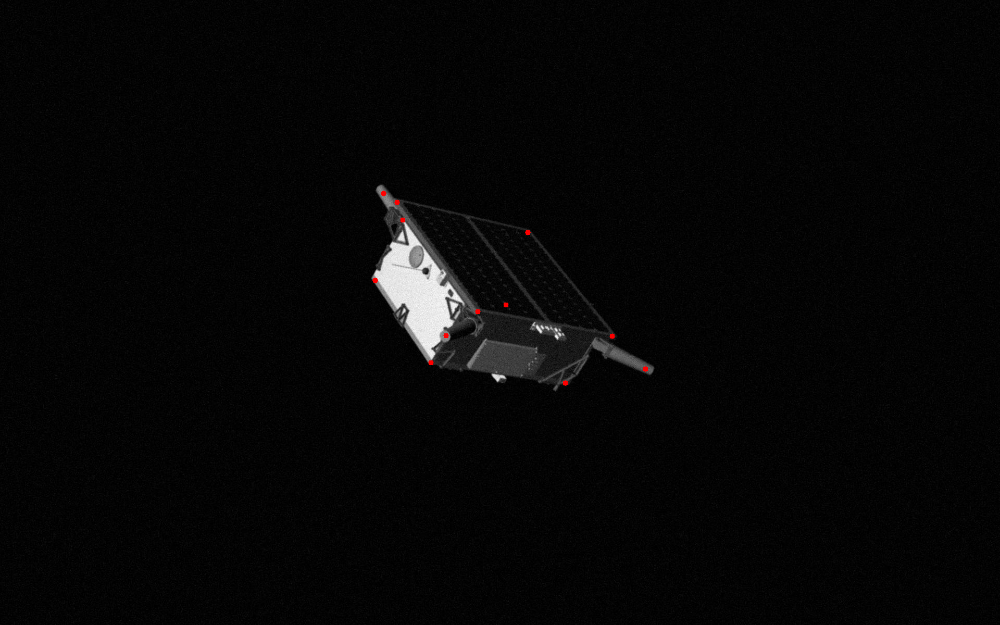

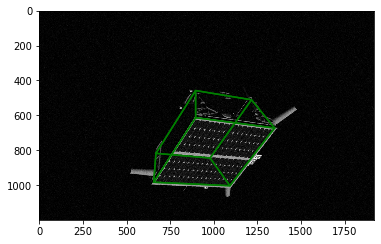

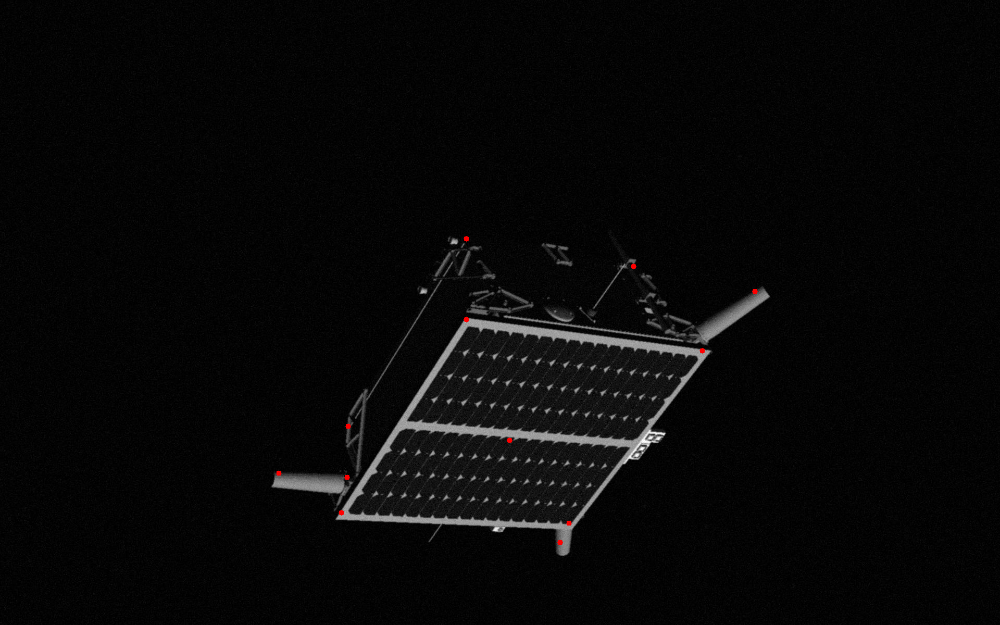

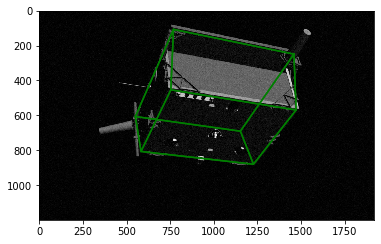

...

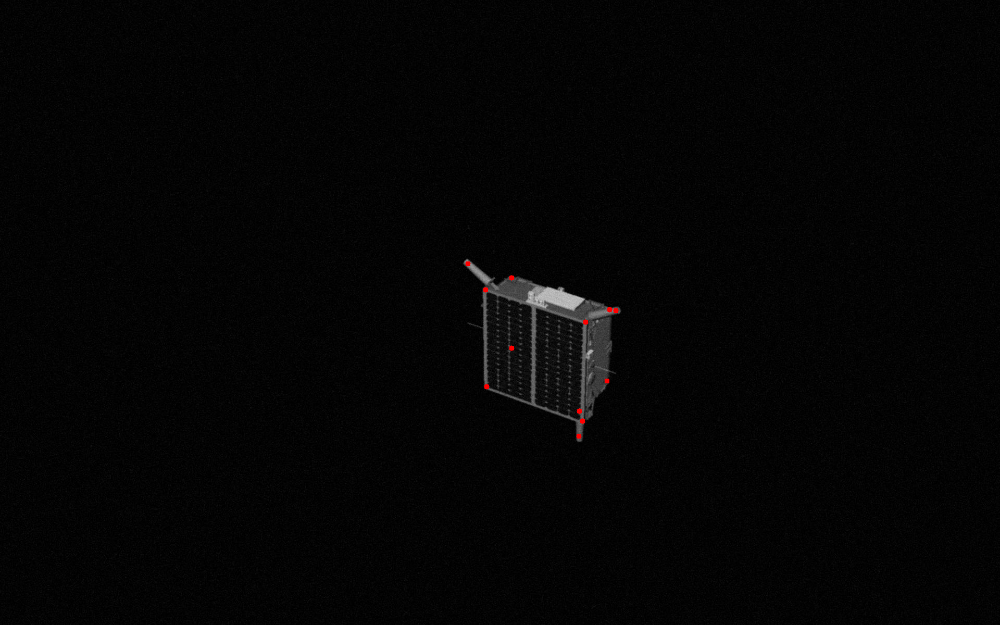

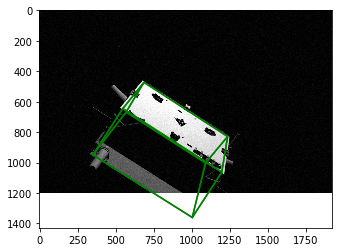

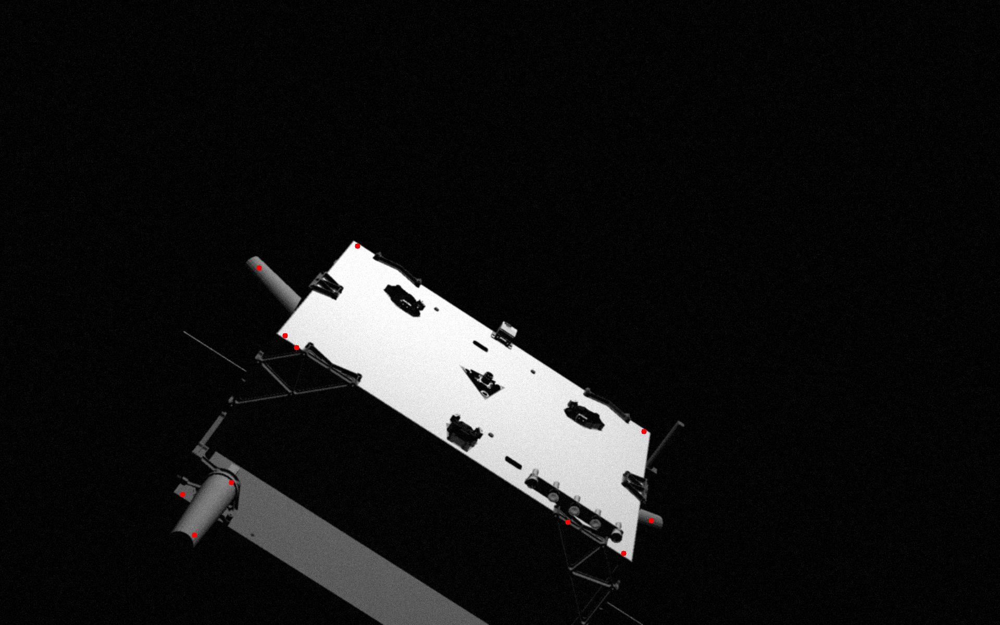

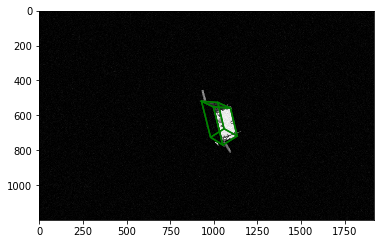

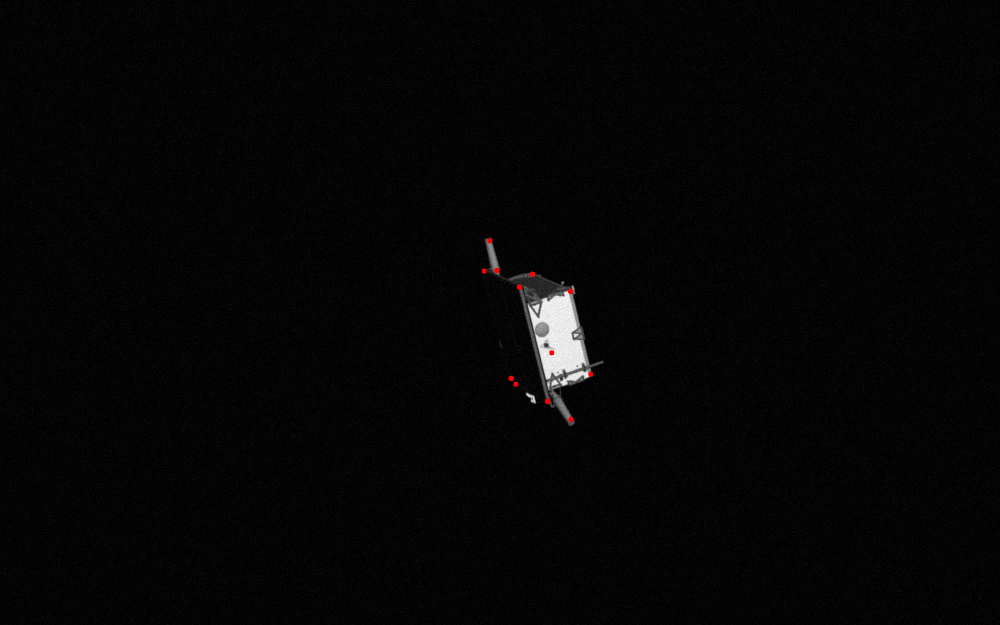

In [ ]:

camera = [[2988.5795163815555,0,960], [0 ,2988.3401159176124,600] ,[0,0, 1]]
dist =[
    -0.22383016606510672,
     0.51409797089106379,
    -0.00066499611998340662,
    -0.00021404771667484594,
    -0.13124227429077406
  ]


labels = [["img000001.jpg",[-0.129896,0.069519,6.457073],[-0.336458,-0.093409,-0.8286,0.437599]],
          ["img000002.jpg",[-0.045457,0.09124,4.236195],[-0.066677,0.512545,0.742901,0.425382]],
          ["img000003.jpg",[0.062054,0.077027,2.860328],[0.885895,0.421982,-0.132624,0.139758]],
          ["img000004.jpg",[-0.138635,0.066346,4.57807],[-0.358977,-0.163489,-0.01317,-0.918822]],
          ["img000005.jpg",[-0.010698,-0.143755,3.822349],[0.27991,-0.907148,-0.0787,-0.304202]],
          ["img000006.jpg",[0.045823,0.357686,7.504268],[-0.642417,-0.0213,0.756631,0.119817]],
          ["img000007.jpg",[0.379978,0.124926,9.966948],[0.273176,-0.922084,-0.075449,0.263522]],
          ["img000008.jpg",[-0.038469,0.151381,2.961553],[-0.217857,-0.184059,0.537455,0.793601]],
          ["img000009.jpg",[0.383848,0.047881,9.883952],[0.587409,-0.023264,-0.790994,-0.169523]]]
#           # ["img000027.jpg",[-0.048703, 0.187951, 6.619656],[0.066266, -0.863296, 0.0988, 0.490477]]]


def quat2dcm(q):
    """ Computing direction cosine matrix from quaternion, adapted from PyNav. """
    # normalizing quaternion
    q = q / np.linalg.norm(q)

    q0 = q[0]
    q1 = q[1]
    q2 = q[2]
    q3 = q[3]

    dcm = np.zeros((3, 3), dtype=np.float32)

    dcm[0, 0] = 2 * q0 ** 2 - 1 + 2 * q1 ** 2
    dcm[1, 1] = 2 * q0 ** 2 - 1 + 2 * q2 ** 2
    dcm[2, 2] = 2 * q0 ** 2 - 1 + 2 * q3 ** 2

    dcm[0, 1] = 2 * q1 * q2 + 2 * q0 * q3
    dcm[0, 2] = 2 * q1 * q3 - 2 * q0 * q2

    dcm[1, 0] = 2 * q1 * q2 - 2 * q0 * q3
    dcm[1, 2] = 2 * q2 * q3 + 2 * q0 * q1

    dcm[2, 0] = 2 * q1 * q3 + 2 * q0 * q2
    dcm[2, 1] = 2 * q2 * q3 - 2 * q0 * q1

    return dcm


def project_keypoints(q, r, K, dist, keypoints):
    """ Projecting 3D keypoints to 2D
        q: quaternion (np.array)
        r: position   (np.array)
        K: camera intrinsic (3,3) (np.array)
        dist: distortion coefficients (5,) (np.array)
        keypoints: N x 3 or 3 x N (np.array)
    """
    # Make sure keypoints are 3 x N
    if keypoints.shape[0] != 3:
        keypoints = np.transpose(keypoints)

    # Keypoints into 4 x N homogenous coordinates
    keypoints = np.vstack((keypoints, np.ones((1, keypoints.shape[1]))))

    # transformation to image frame
    pose_mat = np.hstack((np.transpose(quat2dcm(q)), np.expand_dims(r, 1)))
    xyz      = np.dot(pose_mat, keypoints) # [3 x N]
    x0, y0   = xyz[0,:] / xyz[2,:], xyz[1,:] / xyz[2,:] # [1 x N] each
    # print(x0)
    # print(y0)

    # apply distortion
    r2 = x0*x0 + y0*y0
    cdist = 1 + dist[0]*r2 + dist[1]*r2*r2 + dist[4]*r2*r2*r2
    x  = x0*cdist + dist[2]*2*x0*y0 + dist[3]*(r2 + 2*x0*x0)
    y  = y0*cdist + dist[2]*(r2 + 2*y0*y0) + dist[3]*2*x0*y0

    # apply camera matrix
    points2D = np.vstack((K[0][0]*x + K[0][2], K[1][1]*y + K[1][2]))

    return points2D

def plot_function(q,t,img):
  plt.imshow(img,cmap='gray', vmin = 0, vmax = 255,interpolation='none')

  points2D = project_keypoints(q,t,camera,dist,keypoints)

  plt.plot([points2D[0][0],points2D[0][1],points2D[0][5],points2D[0][4],points2D[0][0]],[points2D[1][0],points2D[1][1],points2D[1][5],points2D[1][4],points2D[1][0]],
                  color='g', linewidth=1.5)
  plt.plot([points2D[0][0],points2D[0][3],points2D[0][7],points2D[0][4],points2D[0][0]],[points2D[1][0],points2D[1][3],points2D[1][7],points2D[1][4],points2D[1][0]],
                  color='g', linewidth=1.5)
  plt.plot([points2D[0][3],points2D[0][2],points2D[0][6],points2D[0][7],points2D[0][3]],[points2D[1][3],points2D[1][2],points2D[1][6],points2D[1][7],points2D[1][3]],
                  color='g', linewidth=1.5)
  plt.plot([points2D[0][2],points2D[0][1],points2D[0][5],points2D[0][6],points2D[0][2]],[points2D[1][2],points2D[1][1],points2D[1][5],points2D[1][6],points2D[1][2]],
                  color='g', linewidth=1.5)
  #upper side
  plt.plot(np.append(points2D[0][:4],points2D[0][0]),np.append(points2D[1][:4],points2D[1][0]),
                  color='g', linewidth=1.5)
  #bottom side
  plt.plot(np.append(points2D[0][4:8],points2D[0][4]),np.append(points2D[1][4:8],points2D[1][4]),
                  color='g', linewidth=1.5)
  plt.show()
  points2D=np.transpose(points2D)

  for item in points2D:
    img = cv.circle(img, (int(item[0]),int(item[1])), radius=5, color=(0, 0, 255), thickness=-1)
  cv2_imshow(img)

# keypoints = np.transpose(loadmat('keypoint3D.mat')['keypoints'])



for i in range(len(labels)):
  image = cv.imread(labels[i][0])
  plot_function(labels[i][2],labels[i][1],image)
  # points2D = project_keypoints(labels[i][2],labels[i][1],camera,dist,keypoints)
